# <p><center style="font-family:newtimeroman;font-size:180%;"> Final Project: Plant Leaf Disease Classification </center></p>
### Table of contents:

* [Import Libraries](#1)
* [Read Data](#2)
* [Visualization Of Dataset](#3)
* [Data Augmentation](#4)
* [Train CNN Model](#5)
* [Evaluate The Model](#6)
* [Train Xception Model](#7)
* [Evaluate The Model](#8)

In [1]:
import shutil
# Corn
source_dir = "/kaggle/input/plantvillage-dataset/color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot"
destination_dir = "/kaggle/working/Gray_leaf_spot"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Corn_(maize)___Common_rust_"
destination_dir = "/kaggle/working/Common_rust"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Corn_(maize)___Northern_Leaf_Blight"
destination_dir = "/kaggle/working/Northern_Leaf_Blight"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Corn_(maize)___healthy"
destination_dir = "/kaggle/working/healthy"
shutil.copytree(source_dir, destination_dir)

# Tomato
source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Bacterial_spot"
destination_dir = "/kaggle/working/Tomato___Bacterial_spot"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Early_blight"
destination_dir = "/kaggle/working/Tomato___Early_blight"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Late_blight"
destination_dir = "/kaggle/working/Tomato___Late_blight"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Leaf_Mold"
destination_dir = "/kaggle/working/Tomato___Leaf_Mold"
shutil.copytree(source_dir, destination_dir)

# Tomato
source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Septoria_leaf_spot"
destination_dir = "/kaggle/working/Tomato___Septoria_leaf_spot"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Spider_mites Two-spotted_spider_mite"
destination_dir = "/kaggle/working/Tomato___Spider_mites Two-spotted_spider_mite"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Target_Spot"
destination_dir = "/kaggle/working/Tomato___Target_Spot"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Tomato_Yellow_Leaf_Curl_Virus"
destination_dir = "/kaggle/working/Tomato___Tomato_Yellow_Leaf_Curl_Virus"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___Tomato_mosaic_virus"
destination_dir = "/kaggle/working/Tomato___Tomato_mosaic_virus"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Tomato___healthy"
destination_dir = "/kaggle/working/Tomato___healthy"
shutil.copytree(source_dir, destination_dir)

# Apple
source_dir = "/kaggle/input/plantvillage-dataset/color/Apple___Apple_scab"
destination_dir = "/kaggle/working/Apple___Apple_scab"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Apple___Black_rot"
destination_dir = "/kaggle/working/Apple___Black_rot"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Apple___Cedar_apple_rust"
destination_dir = "/kaggle/working/Apple___Cedar_apple_rust"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Apple___healthy"
destination_dir = "/kaggle/working/Apple___healthy"
shutil.copytree(source_dir, destination_dir)

# Potato
source_dir = "/kaggle/input/plantvillage-dataset/color/Potato___Early_blight"
destination_dir = "/kaggle/working/Potato___Early_blight"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Potato___Late_blight"
destination_dir = "/kaggle/working/Potato___Late_blight"
shutil.copytree(source_dir, destination_dir)

source_dir = "/kaggle/input/plantvillage-dataset/color/Potato___healthy"
destination_dir = "/kaggle/working/Potato___healthy"
shutil.copytree(source_dir, destination_dir)


'/kaggle/working/Potato___healthy'

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Import Libraries </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [24]:
import os

import pandas as pd
import numpy as np
import seaborn as sns

from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report 

import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import models, layers
import keras
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from tensorflow.keras.utils import to_categorical, plot_model
import imgaug.augmenters as iaa

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Read The Dataset</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [3]:
data_path = '/kaggle/working/'

In [4]:
classes = [d for d in os.listdir(data_path) if os.path.isdir(os.path.join(data_path, d))]

print("Dataset Classes:")
for cls in classes:
    print(cls)

Dataset Classes:
Gray_leaf_spot
Apple___healthy
Tomato___healthy
.virtual_documents
Tomato___Early_blight
Apple___Apple_scab
Tomato___Bacterial_spot
Apple___Cedar_apple_rust
Northern_Leaf_Blight
Tomato___Late_blight
Potato___Early_blight
Potato___healthy
healthy
Apple___Black_rot
Tomato___Septoria_leaf_spot
Tomato___Spider_mites Two-spotted_spider_mite
Tomato___Target_Spot
Tomato___Leaf_Mold
Common_rust
Tomato___Tomato_mosaic_virus
Potato___Late_blight
Tomato___Tomato_Yellow_Leaf_Curl_Virus


In [28]:
import os
import random
import shutil

def limit_images_per_class(data_path, max_images=350):
    for class_name in os.listdir(data_path):
        class_path = os.path.join(data_path, class_name)
        if os.path.isdir(class_path):
            images = [f for f in os.listdir(class_path) if f.lower().endswith(('.JPG', '.jpg'))]
            if len(images) > max_images:
                images_to_remove = random.sample(images, len(images) - max_images)
                for img in images_to_remove:
                    os.remove(os.path.join(class_path, img))
                print(f"Reduced {class_name} to {max_images} images")
            else:
                print(f"{class_name} already has {len(images)} images (≤ {max_images})")

limit_images_per_class(data_path, max_images=350)

Potato___Late_blight already has 350 images (≤ 350)
Tomato___Bacterial_spot already has 350 images (≤ 350)
Tomato___Leaf_Mold already has 350 images (≤ 350)
Potato___Early_blight already has 350 images (≤ 350)
Tomato___Target_Spot already has 350 images (≤ 350)
Gray_leaf_spot already has 350 images (≤ 350)
Apple___Cedar_apple_rust already has 275 images (≤ 350)
Northern_Leaf_Blight already has 350 images (≤ 350)
Apple___healthy already has 350 images (≤ 350)
healthy already has 350 images (≤ 350)
Apple___Black_rot already has 350 images (≤ 350)
Potato___healthy already has 152 images (≤ 350)
Apple___Apple_scab already has 350 images (≤ 350)
Tomato___healthy already has 350 images (≤ 350)
Common_rust already has 350 images (≤ 350)
Tomato___Spider_mites Two-spotted_spider_mite already has 350 images (≤ 350)
Tomato___Late_blight already has 350 images (≤ 350)
Tomato___Septoria_leaf_spot already has 350 images (≤ 350)
Tomato___Early_blight already has 350 images (≤ 350)
Tomato___Tomato_Yel

In [29]:
import os

def count_images_in_folders(data_path):
    for folder_name in os.listdir(data_path):
        folder_path = os.path.join(data_path, folder_name)
        
        # Check if it's a directory
        if os.path.isdir(folder_path):
            # Count image files with common extensions
            image_files = [f for f in os.listdir(folder_path) 
                           if f.lower().endswith(('.JPG', '.jpg'))]
            
            print(f"{folder_name}: {len(image_files)} images")

count_images_in_folders(data_path)


Potato___Late_blight: 350 images
Tomato___Bacterial_spot: 350 images
Tomato___Leaf_Mold: 350 images
Potato___Early_blight: 350 images
Tomato___Target_Spot: 350 images
Gray_leaf_spot: 350 images
Apple___Cedar_apple_rust: 275 images
Northern_Leaf_Blight: 350 images
Apple___healthy: 350 images
healthy: 350 images
Apple___Black_rot: 350 images
Potato___healthy: 152 images
Apple___Apple_scab: 350 images
Tomato___healthy: 350 images
Common_rust: 350 images
Tomato___Spider_mites Two-spotted_spider_mite: 350 images
Tomato___Late_blight: 350 images
Tomato___Septoria_leaf_spot: 350 images
Tomato___Early_blight: 350 images
Tomato___Tomato_Yellow_Leaf_Curl_Virus: 350 images
Tomato___Tomato_mosaic_virus: 350 images
.virtual_documents: 0 images


#### Here,labels are the folder name and data images are inside the respective folder. Lets create a dataframe for the filepath and labels

In [5]:
def create_dataframe(data_path):
    filepaths = []
    labels = []

    for fold in os.listdir(data_path):
        f_path = os.path.join(data_path, fold)
        if os.path.isdir(f_path):
            imgs = os.listdir(f_path)
            for img in imgs:
                img_path = os.path.join(f_path, img)
                filepaths.append(img_path)
                labels.append(fold)

    fseries = pd.Series(filepaths, name='Filepaths')
    lseries = pd.Series(labels, name='Labels')
    return pd.concat([fseries, lseries], axis=1)

# Create DataFrame for the dataset
df = create_dataframe(data_path)

In [6]:
df

,Filepaths,Labels
0,/kaggle/working/Gray_leaf_spot/4d603da2-b570-4...,Gray_leaf_spot
1,/kaggle/working/Gray_leaf_spot/97231a3c-2a80-4...,Gray_leaf_spot
2,/kaggle/working/Gray_leaf_spot/3af22715-5f08-4...,Gray_leaf_spot
3,/kaggle/working/Gray_leaf_spot/bc690bb9-1611-4...,Gray_leaf_spot
4,/kaggle/working/Gray_leaf_spot/abf68bb5-f883-4...,Gray_leaf_spot
...,...,...
27330,/kaggle/working/Tomato___Tomato_Yellow_Leaf_Cu...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
27331,/kaggle/working/Tomato___Tomato_Yellow_Leaf_Cu...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
27332,/kaggle/working/Tomato___Tomato_Yellow_Leaf_Cu...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
27333,/kaggle/working/Tomato___Tomato_Yellow_Leaf_Cu...,Tomato___Tomato_Yellow_Leaf_Curl_Virus


### Splitting data into training, testing and validation sets

In [7]:
 # Step 1: Split into 70% training and 30% dummy
train_df, dummy_df = train_test_split(df, train_size=0.7, shuffle=True, random_state=42)

# Step 2: Split dummy_df into 20% testing and 10% validation
test_df, valid_df = train_test_split(dummy_df, train_size=2/3, shuffle=True, random_state=42)

In [8]:
print(train_df.shape)
print(dummy_df.shape)
print(valid_df.shape)
print(test_df.shape)

(19134, 2)
(8201, 2)
(2734, 2)
(5467, 2)


**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Data Augmentation</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [9]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Validation and test data generators remain the same
valid_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

In [10]:
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    x_col='Filepaths',
    y_col='Labels',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=True,
    seed=42
)

valid_generator = valid_datagen.flow_from_dataframe(
    dataframe=valid_df,
    x_col='Filepaths',
    y_col='Labels',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    x_col='Filepaths',
    y_col='Labels',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 19134 validated image filenames belonging to 21 classes.
Found 2734 validated image filenames belonging to 21 classes.
Found 5467 validated image filenames belonging to 21 classes.


In [11]:
print(f'Training samples: {train_generator.samples}')
print(f'Validation samples: {valid_generator.samples}')
print(f'Test samples: {test_generator.samples}')

Training samples: 19134
Validation samples: 2734
Test samples: 5467


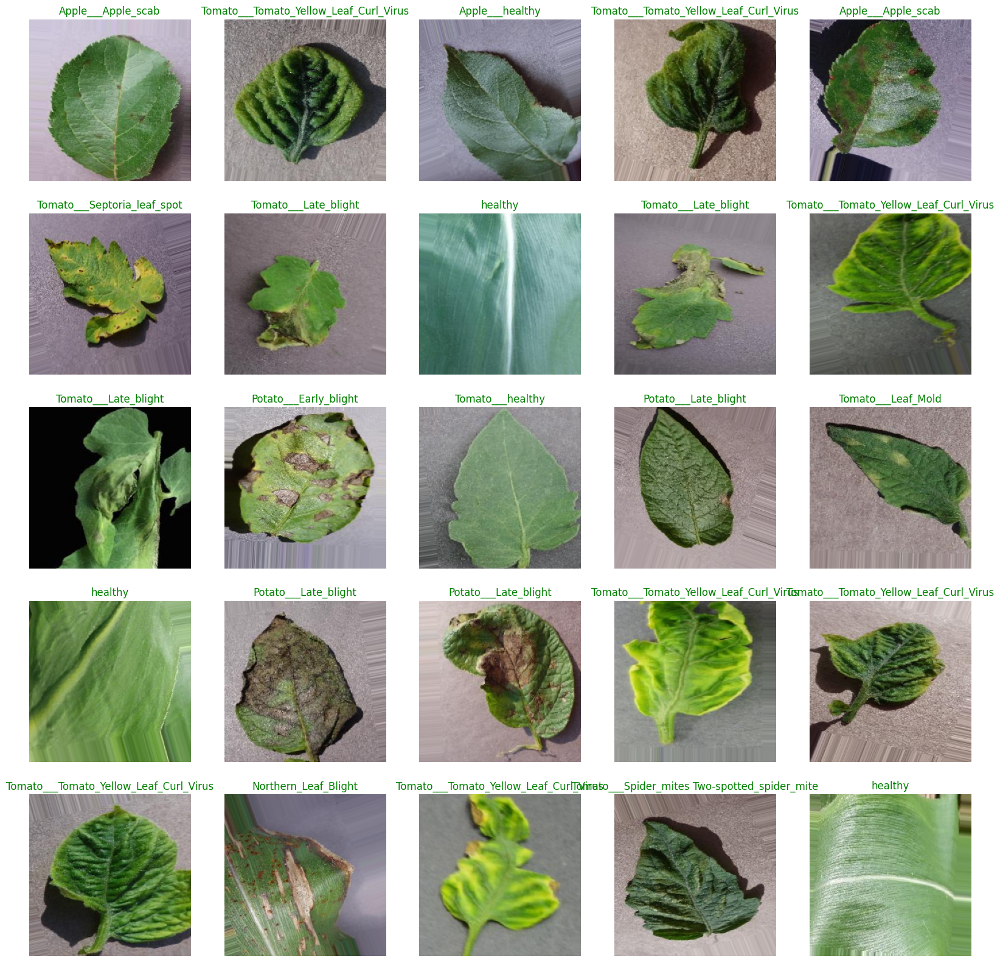

In [13]:
import matplotlib.pyplot as plt
import numpy as np

def show_images(image_gen):
    class_dict = image_gen.class_indices
    classes = list(class_dict.keys())
    
    images, labels = next(image_gen)
    
    plt.figure(figsize=(20, 20))
    
    num_images = min(len(labels), 25)
    
    for i in range(num_images):
        plt.subplot(5, 5, i + 1)
        
        image = images[i]
        
        plt.imshow(image)
        
        index = np.argmax(labels[i])
        class_name = classes[index]
        
        plt.title(class_name, color="green", fontsize=12)
        plt.axis('off')
    
    plt.show()

show_images(train_generator)

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Train CNN Model</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [13]:
input_shape = (224, 224, 3)  
n_classes = len(train_generator.class_indices)

model = keras.Sequential([
    keras.layers.Conv2D(filters=64, kernel_size=(7, 7), strides=(3, 3), activation='relu', input_shape=input_shape),
    keras.layers.MaxPool2D(pool_size=(3, 3)),

    keras.layers.Conv2D(filters=128, kernel_size=(3, 3), activation='relu', padding='same'),
    keras.layers.MaxPool2D(pool_size=(2, 2)),

    keras.layers.Conv2D(filters=128, kernel_size=(3, 3), activation='relu', padding='same'),
    keras.layers.MaxPool2D(pool_size=(2, 2)),

    keras.layers.Conv2D(filters=256, kernel_size=(3, 3), activation='relu', padding='same'),
    keras.layers.MaxPool2D(pool_size=(2, 2)),

    keras.layers.Conv2D(filters=256, kernel_size=(3, 3), activation='relu', padding='same'),
    keras.layers.MaxPool2D(pool_size=(2, 2)),

    keras.layers.Flatten(),
    keras.layers.Dense(256, activation='relu'),
    keras.layers.Dense(256, activation='relu'),
    keras.layers.Dropout(0.5),


    keras.layers.Dense(n_classes, activation='softmax')
])


model.compile(
    loss='categorical_crossentropy',
    optimizer=tf.optimizers.Adam(),
    metrics=['accuracy']
)

model.summary()

/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 73, 73, 64)     │         9,472 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 24, 24, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 24, 24, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 12, 12, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 12, 12, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 6, 6, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 6, 6, 256)      │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 3, 3, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 3, 3, 256)      │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 1, 1, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 21)             │         5,397 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,253,141 (4.78 MB)

 Trainable params: 1,253,141 (4.78 MB)

 Non-trainable params: 0 (0.00 B)

In [14]:
# Define callbacks
early_stopping = EarlyStopping(
    monitor='val_loss',  # Monitor validation loss
    patience=5,          # Number of epochs with no improvement after which training will be stopped
    restore_best_weights=True  # Restore model weights from the epoch with the best value of the monitored quantity
)

model_checkpoint = ModelCheckpoint(
    'best_model.keras',  # Path to save the model
    monitor='val_loss',  # Monitor validation loss
    save_best_only=True,  # Save only the best model
    mode='min',  # Save the model with the minimum validation loss
    verbose=1  # Verbosity mode
)

In [15]:
history = model.fit(
    train_generator,
    batch_size=32,
    validation_data=valid_generator,
    epochs=50,
    callbacks=[early_stopping, model_checkpoint] 
)

Epoch 1/50


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


598/598 ━━━━━━━━━━━━━━━━━━━━ 0s 645ms/step - accuracy: 0.2584 - loss: 2.4901
Epoch 1: val_loss improved from inf to 1.58536, saving model to best_model.keras
598/598 ━━━━━━━━━━━━━━━━━━━━ 412s 680ms/step - accuracy: 0.2585 - loss: 2.4896 - val_accuracy: 0.4909 - val_loss: 1.5854
Epoch 2/50
598/598 ━━━━━━━━━━━━━━━━━━━━ 0s 647ms/step - accuracy: 0.5387 - loss: 1.4760
Epoch 2: val_loss improved from 1.58536 to 0.75816, saving model to best_model.keras
598/598 ━━━━━━━━━━━━━━━━━━━━ 400s 664ms/step - accuracy: 0.5388 - loss: 1.4758 - val_accuracy: 0.7520 - val_loss: 0.7582
Epoch 3/50
598/598 ━━━━━━━━━━━━━━━━━━━━ 0s 640ms/step - accuracy: 0.7056 - loss: 0.9185
Epoch 3: val_loss improved from 0.75816 to 0.59247, saving model to best_model.keras
598/598 ━━━━━━━━━━━━━━━━━━━━ 396s 657ms/step - accuracy: 0.7056 - loss: 0.9184 - val_accuracy: 0.8142 - val_loss: 0.5925
Epoch 4/50
598/598 ━━━━━━━━━━━━━━━━━━━━ 0s 639ms/step - accuracy: 0.7650 - loss: 0.7076
Epoch 4: val_loss improved from 0.59247 to 0.

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Evaluate CNN Model</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [16]:
scores = model.evaluate(test_generator)
scores

171/171 ━━━━━━━━━━━━━━━━━━━━ 21s 123ms/step - accuracy: 0.9382 - loss: 0.1873


[0.1802385300397873, 0.9409182071685791]

171/171 ━━━━━━━━━━━━━━━━━━━━ 21s 121ms/step


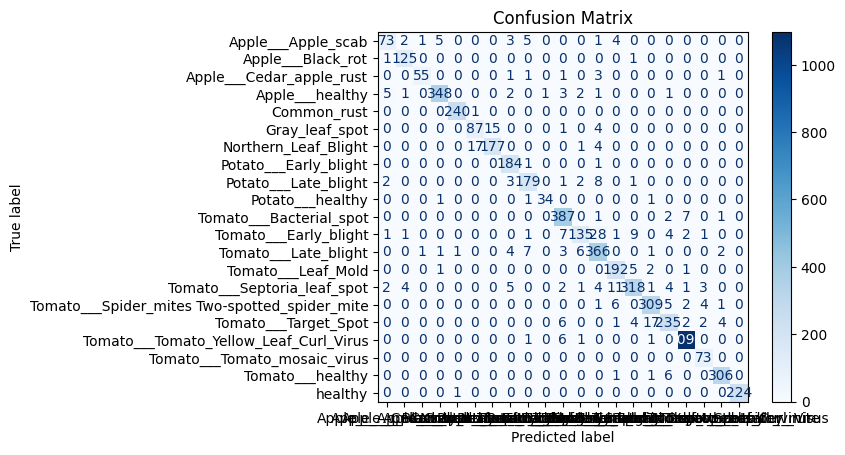

In [17]:
predictions = model.predict(test_generator)

predicted_classes = np.argmax(predictions, axis=1)

true_classes = test_generator.classes

cm = confusion_matrix(true_classes, predicted_classes)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=test_generator.class_indices)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

In [18]:
test_generator.reset()
predictions = model.predict(test_generator)
predicted_classes = np.argmax(predictions, axis=1)

171/171 ━━━━━━━━━━━━━━━━━━━━ 21s 122ms/step


In [19]:
true_classes = test_generator.classes

In [20]:
from sklearn.metrics import classification_report  

class_labels = list(test_generator.class_indices.keys())
report = classification_report(true_classes, predicted_classes, target_names=class_labels)
print(report)

                                               precision    recall  f1-score   support

                           Apple___Apple_scab       0.87      0.78      0.82        94
                            Apple___Black_rot       0.94      0.98      0.96       127
                     Apple___Cedar_apple_rust       0.96      0.89      0.92        62
                              Apple___healthy       0.98      0.96      0.97       364
                                  Common_rust       0.99      1.00      0.99       241
                               Gray_leaf_spot       0.83      0.81      0.82       107
                         Northern_Leaf_Blight       0.92      0.89      0.91       199
                        Potato___Early_blight       0.91      0.99      0.95       186
                         Potato___Late_blight       0.91      0.91      0.91       196
                             Potato___healthy       0.97      0.92      0.94        37
                      Tomato___Bacterial_s

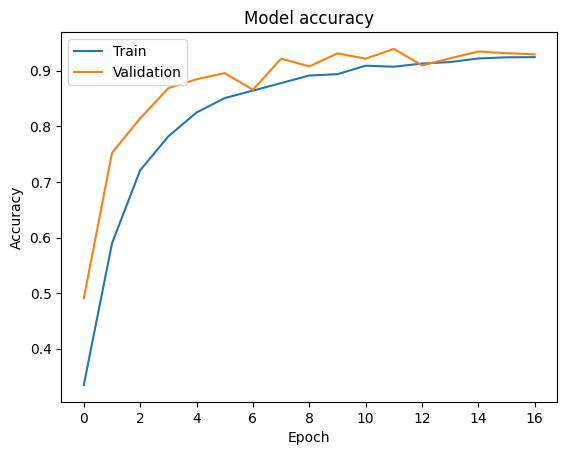

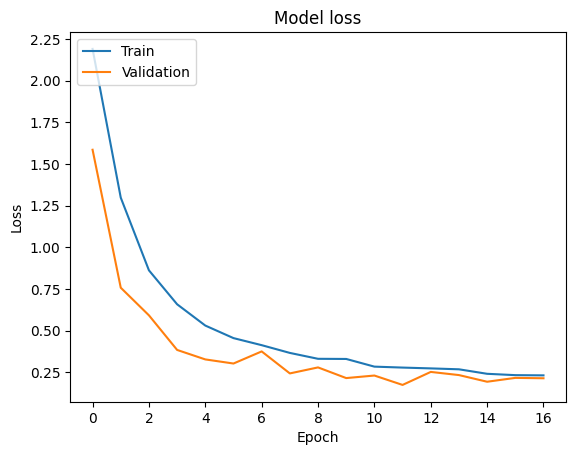

In [21]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [22]:
import numpy as np

class_names = list(test_generator.class_indices.keys())

images_batch, labels_batch = next(test_generator)

first_image = images_batch[0]
first_label = np.argmax(labels_batch[0])  

batch_prediction = model.predict(images_batch)
predicted_label_index = np.argmax(batch_prediction[0])

print("Actual label:", class_names[first_label])
print("Predicted label:", class_names[predicted_label_index])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
Actual label: Tomato___Late_blight
Predicted label: Potato___Early_blight


In [23]:
import tensorflow as tf
import numpy as np

def predict(model, img, class_names):
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)  # Create a batch

    predictions = model.predict(img_array)
    predicted_class = class_names[np.argmax(predictions[0])]
    confidence = round(100 * np.max(predictions[0]), 2)
    return predicted_class, confidence

class_names = list(test_generator.class_indices.keys())

images_batch, labels_batch = next(test_generator)
for i in range(min(len(images_batch), 9)):
    predicted_class, confidence = predict(model, images_batch[i], class_names)
    actual_class = class_names[np.argmax(labels_batch[i])]

    print(f"Actual: {actual_class}, Predicted: {predicted_class}, Confidence: {confidence}%")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
Actual: Tomato___Bacterial_spot, Predicted: Tomato___Bacterial_spot, Confidence: 99.24%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Actual: Tomato___Early_blight, Predicted: Tomato___Late_blight, Confidence: 83.88%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Actual: Tomato___Spider_mites Two-spotted_spider_mite, Predicted: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 99.99%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Actual: Tomato___Early_blight, Predicted: Tomato___Early_blight, Confidence: 90.97%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Actual: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Predicted: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Confidence: 100.0%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Actual: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Predicted: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Confidence: 99.99%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Actual: Tomato___Bacterial_spot, Predicted: Tomato___Bacterial_spot, Confidence: 100.0%
1/1 ━━━━━━━━━━━━━━━━━━

In [24]:
model.save("Model_P_v8.h5")

## Addditional Models

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Train Xception Model</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [15]:
base_model = tf.keras.applications.xception.Xception(weights= 'imagenet' ,include_top = False , input_shape = (224,224,3) ,
                                                     pooling = 'max' )
model = keras.models.Sequential([
    base_model,
    keras.layers.BatchNormalization(),
    keras.layers.Dense(256,activation = 'relu'),
    keras.layers.Dropout(.5),
    keras.layers.Dense(21 , activation= 'softmax' )
])
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ xception (Functional)           │ ?                      │    20,861,480 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ ?                      │   0 (unbuilt) │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 20,861,480 (79.58 MB)

 Trainable params: 20,806,952 (79.37 MB)

 Non-trainable params: 54,528 (213.00 KB)

In [ ]:
checkpoint_cb =ModelCheckpoint("xception_model.keras", save_best_only=True)
early_stopping_cb =EarlyStopping(patience=5, restore_best_weights=True)
model.compile(optimizer ='adam', loss='categorical_crossentropy', metrics=['accuracy',keras.metrics.AUC()])
hist=model.fit(train_generator,epochs=5,validation_data=valid_generator,callbacks=[checkpoint_cb,early_stopping_cb])

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Evaluate The Model</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [ ]:
hist_=pd.DataFrame(hist.history)
hist_

In [ ]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
plt.plot(hist_['loss'],'b-o',label='Train_Loss')
plt.plot(hist_['val_loss'],'r-o',label='Validation_Loss')
plt.title('Train_Loss & Validation_Loss',fontsize=20)
plt.legend()
plt.subplot(1,3,2)
plt.plot(hist_['accuracy'],'b-o',label='Train_Accuracy')
plt.plot(hist_['val_accuracy'],'r-o',label='Validation_Accuracy')
plt.title('Train_Accuracy & Validation_Accuracy',fontsize=20)
plt.legend()
plt.subplot(1,3,3)
plt.plot(hist_.iloc[:,1],'b-o',label='Train_auc')
plt.plot(hist_.iloc[:,4],'r-o',label='Validation_auc')
plt.title('Train_AUC & Validation_AUC',fontsize=20)
plt.legend()
plt.show()

In [18]:
score, acc,auc = model.evaluate(test_generator)
print('Test Loss =', score)
print('Test Accuracy =', acc)
print('Test AUC =', auc)

171/171 ━━━━━━━━━━━━━━━━━━━━ 653s 4s/step - accuracy: 0.9332 - auc_1: 0.9936 - loss: 0.2529
Test Loss = 0.23260383307933807
Test Accuracy = 0.9334186911582947
Test AUC = 0.9951682090759277


In [19]:
# Get true labels
y_test = test_generator.classes
# Predict probabilities for each class
predictions = model.predict(test_generator)
# Convert predicted probabilities to class labels (choose the class with the highest probability)
y_pred = np.argmax(predictions, axis=1)
# Flatten both arrays just in case
y_test = np.ravel(y_test)
y_pred = np.ravel(y_pred)
# Create a DataFrame to compare actual vs predicted labels
df = pd.DataFrame({'Actual': y_test, 'Prediction': y_pred})
# Display the DataFrame
df.head()  # Show the first few rows of the comparison

171/171 ━━━━━━━━━━━━━━━━━━━━ 642s 4s/step


,Actual,Prediction
0,17,17
1,10,10
2,17,17
3,10,10
4,1,1


In [21]:
class_ = list(test_generator.class_indices.keys())
class_

['Apple___Apple_scab',
 'Apple___Black_rot',
 'Apple___Cedar_apple_rust',
 'Apple___healthy',
 'Common_rust',
 'Gray_leaf_spot',
 'Northern_Leaf_Blight',
 'Potato___Early_blight',
 'Potato___Late_blight',
 'Potato___healthy',
 'Tomato___Bacterial_spot',
 'Tomato___Early_blight',
 'Tomato___Late_blight',
 'Tomato___Leaf_Mold',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Tomato___Target_Spot',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___healthy',
 'healthy']

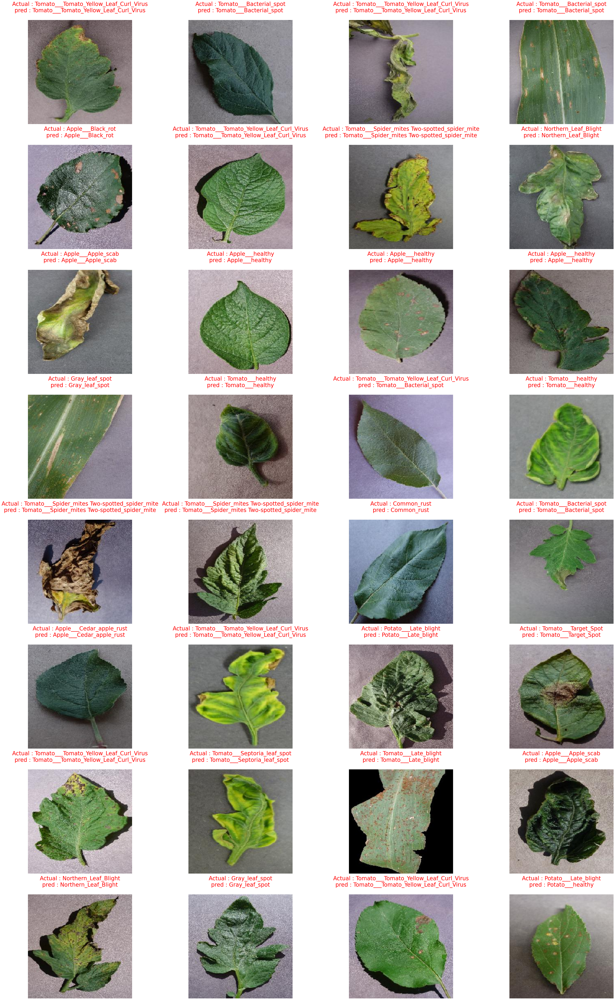

In [22]:
batch = next(test_generator)
images= batch[0]
plt.figure(figsize=(50,80))
for n in range(32):
    plt.subplot(8,4,n+1)
    plt.imshow(images[n])
    plt.axis('off')
    text = f'Actual : {class_[int(y_test[n])]}\npred : {class_[int(y_pred[n])]}\n'
    plt.title(text,color= 'red',fontsize=25)

array([[ 109,    3,    0,    0,    0,    0,    0,    0,    0,    0,    1,
           0,    1,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,  118,    0,    0,    0,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,   16,   43,    0,    0,    0,    0,    0,    0,    0,    5,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0,  302,    0,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0,    0,  235,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0,    0,    0,    1,    0,    0,    0],
       [   0,    0,    0,    0,    0,   88,   20,    0,    0,    0,    1,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,    1,    0,    0,    0,    3,  191,    0,    0,    0,    1,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0],

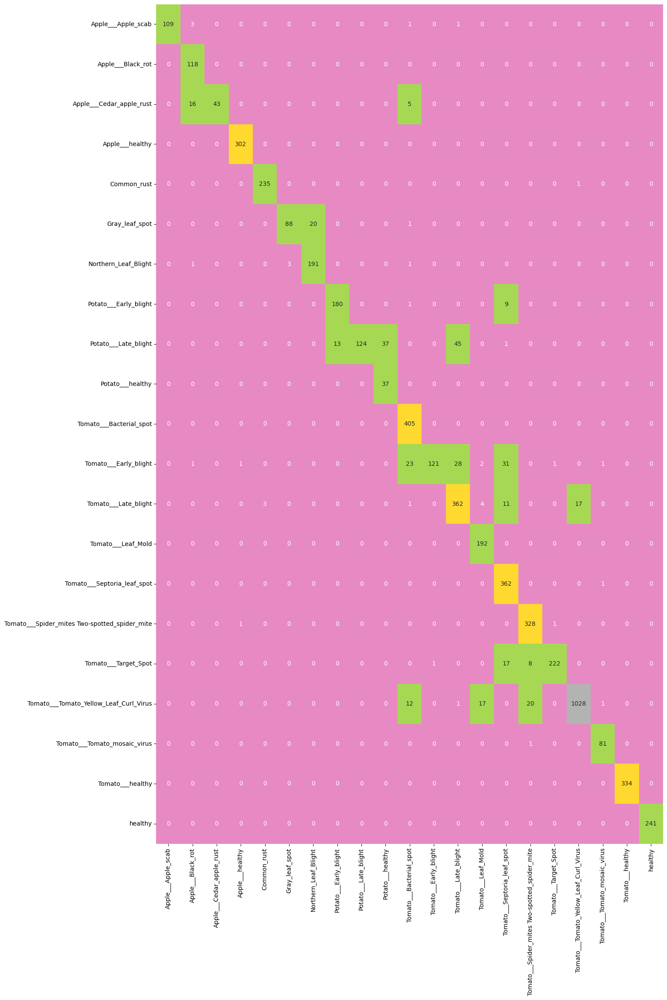

In [25]:
CM = confusion_matrix(y_test,y_pred)
plt.figure(figsize=(15,25))
sns.heatmap(CM,fmt='g',center = True,cbar=False,annot=True,cmap='Set2',xticklabels=class_,yticklabels=class_)
CM

In [26]:
ClassificationReport = classification_report(y_test,y_pred,target_names=class_)
print('Classification Report is : ', ClassificationReport)

Classification Report is :                                                 precision    recall  f1-score   support

                           Apple___Apple_scab       1.00      0.96      0.98       114
                            Apple___Black_rot       0.85      1.00      0.92       118
                     Apple___Cedar_apple_rust       1.00      0.67      0.80        64
                              Apple___healthy       0.99      1.00      1.00       302
                                  Common_rust       0.99      1.00      0.99       236
                               Gray_leaf_spot       0.97      0.81      0.88       109
                         Northern_Leaf_Blight       0.91      0.97      0.94       196
                        Potato___Early_blight       0.93      0.95      0.94       190
                         Potato___Late_blight       1.00      0.56      0.72       220
                             Potato___healthy       0.50      1.00      0.67        37
              

In [27]:
model.save("xception_model.h5")